![人工智慧 - 自由團隊](https://raw.githubusercontent.com/chenkenanalytic/img/master/af/aifreeteam.png)


<center>Welcome to the data deployment practice of Traditional Chinese Handwriting Dataset by AI . FREE Team.</center>
<br>
<center>歡迎大家來到 AI . FREE Team 所開發的繁體中文手寫資料部署實作。 </center>
<br>

<center>(Author: Chen Ken, Yen-Lin 博士；Date of published: 2020/4/21；AI . FREE Team Website: https://aifreeblog.herokuapp.com/)</center>

In [ ]:
!git clone https://github.com/chenkenanalytic/handwritting_data_all.git --depth 1

Cloning into 'handwritting_data_all'...
remote: Enumerating objects: 17, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 17 (delta 0), reused 15 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (17/17), 926.83 MiB | 17.41 MiB/s, done.
Updating files: 100% (15/15), done.


In [ ]:
!cat ./handwritting_data_all/all_data.zip* > ./handwritting_data_all/all_data.zip

In [ ]:
!rm -rf cleaned_data/
!unzip -O big5 ./handwritting_data_all/all_data.zip -d "."

Archive:  ./handwritting_data_all/all_data.zip
   creating: ./cleaned_data/
   creating: ./cleaned_data/1/
   creating: ./cleaned_data/10/
   creating: ./cleaned_data/100/
   creating: ./cleaned_data/1000/
   creating: ./cleaned_data/10000/
  inflating: ./cleaned_data/10000/颮_0.png  
  inflating: ./cleaned_data/10000/颮_1.png  
  inflating: ./cleaned_data/10000/颮_10.png  
  inflating: ./cleaned_data/10000/颮_11.png  
  inflating: ./cleaned_data/10000/颮_12.png  
  inflating: ./cleaned_data/10000/颮_13.png  
  inflating: ./cleaned_data/10000/颮_14.png  
  inflating: ./cleaned_data/10000/颮_15.png  
  inflating: ./cleaned_data/10000/颮_16.png  
  inflating: ./cleaned_data/10000/颮_17.png  
  inflating: ./cleaned_data/10000/颮_18.png  
  inflating: ./cleaned_data/10000/颮_19.png  
  inflating: ./cleaned_data/10000/颮_2.png  
  inflating: ./cleaned_data/10000/颮_20.png  
  inflating: ./cleaned_data/10000/颮_21.png  
  inflating: ./cleaned_data/10000/颮_22.png  
  inflating: ./cleaned_data/10000/颮_23.png

In [3]:
from platform import python_version
import os
import shutil
import numpy as np
import pandas as pd
import PIL.Image
from matplotlib import pyplot as plt
from matplotlib.font_manager import findfont, FontProperties
from pathlib import Path
import zipfile
import shutil
import threading
from tqdm import tqdm
import random
import re

import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, ImageDataGenerator
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import *

'''
繁體中文顯示設定
'''
from matplotlib.font_manager import FontProperties

default_type = findfont( FontProperties( family=FontProperties().get_family() ) )
ttf_path = Path('/'.join( default_type.split('/')[:-1] ))  # 預設字型的資料夾路徑


DisplayChinese = Path("./matplotlib_Display_Chinese_in_Colab")
if not DisplayChinese.exists(  ):
    !git clone https://github.com/YenLinWu/matplotlib_Display_Chinese_in_Colab --depth 1

msj_name = ""
for item in DisplayChinese.glob( '*.ttf' ):
    msj_ttf_path = item.absolute()
    msj_name = msj_ttf_path.name


try:
    shutil.move( msj_ttf_path, ttf_path )
except:
    pass
finally:
    shutil.rmtree( DisplayChinese )
font = FontProperties( fname=ttf_path/msj_name )

CurrentFolder = Path(".")
OutputFolder = Path('./cleaned_data')

ImportError: libhipsparselt.so.0: cannot open shared object file: No such file or directory

In [ ]:
Path(OutputFolder).mkdir(exist_ok=True)

ImageList = list(OutputFolder.glob('**/*.png'))

def CreateMoveImageThread(img_path: Path):
    w = img_path.name.split('_')[0]
    (OutputFolder / w).mkdir(exist_ok=True) # Create the new word folder in OutputPath.
    shutil.move(img_path, OutputFolder / w / img_path.name)

MoveJoinSet: list[threading.Thread] = [threading.Thread(target=CreateMoveImageThread, args=(i,)) for i in tqdm(ImageList, desc="Spawnning task")]

for thread in tqdm(MoveJoinSet, desc="Starting job"):
    thread.start()

for thread in tqdm(MoveJoinSet, desc="Moving images"):
    thread.join()


for folder in OutputFolder.iterdir():
  if not re.match(r"[0-9]",folder.name):
    continue
  shutil.rmtree(folder)

print( 'Data Deployment completed.' )

Moving images: 100%|██████████| 684677/684677 [00:07<00:00, 94486.98it/s] 


Data Deployment completed.


In [1]:
a=0
b=0

for item in OutputFolder.iterdir():
  a += 1
  b += len(list(item.iterdir()))

print('總共: ' + str(a) + '個字, ' + str(b) + '張圖片')

NameError: name 'OutputFolder' is not defined

In [ ]:
from pathlib import Path
import random
import cv2
import numpy as np
import shutil

SrcFolder = OutputFolder
DstFolder = Path('./Processed_Handwritten_Data')

if DstFolder.exists():
    shutil.rmtree(DstFolder)

DstFolder.mkdir(parents=True)


def apply_random_transform(image: cv2.Mat) -> cv2.Mat:
    """
    Apply random transformations to an image: rotation, shearing, scaling
    """
    rows, cols = image.shape[:2]

    # Random rotation (-180 to 180 degrees)
    angle = random.uniform(-15, 15)
    rotation_matrix = cv2.getRotationMatrix2D((cols, rows), angle, 1)

    # # Random scaling (0.75 to 1.25)
    scale = random.uniform(0.8, 1.05)
    scaled_matrix = rotation_matrix.copy()
    scaled_matrix[0, 0] *= scale
    scaled_matrix[1, 1] *= scale

    # # Random shearing
    shear_x = random.uniform(-0.1, 0.1)
    shear_y = random.uniform(-0.1, 0.1)
    shear_matrix = np.float32([[1, 0, 0], [0, 1, 0]])

    # Apply transformations
    rotated = cv2.warpAffine(image, scaled_matrix, (cols, rows), borderValue=(255, 255, 255))
    transformed = cv2.warpAffine(rotated, shear_matrix, (cols, rows), borderValue=(255, 255, 255))

    return transformed

def process_and_save_images(n=10):
    """
    Process images in the source folder, apply transformations, and save to destination folder
    """
    CharFolders = [f for f in SrcFolder.iterdir() if f.is_dir()][:n]
    for CharFolder in CharFolders:
        DstCharFolder = DstFolder / CharFolder.name
        DstCharFolder.mkdir(parents=True, exist_ok=True)
        ImgFiles = list(CharFolder.glob('*.png'))
        print(ImgFiles)
        for ImgFile in ImgFiles:
            image = cv2.imread(str(ImgFile), cv2.IMREAD_GRAYSCALE)
            cv2.imwrite(str(DstCharFolder / f"{ImgFile.stem}_0.png"), image)  # Save original image
            transformed_images = [apply_random_transform(image) for _ in range(200)]
            for i, transformed_image in enumerate(transformed_images):
                DstImgFile = DstCharFolder / f"{ImgFile.stem}_{i + 1}.png"
                cv2.imwrite(str(DstImgFile), transformed_image)


process_and_save_images(5)

[PosixPath('cleaned_data/輅/輅_53.png'), PosixPath('cleaned_data/輅/輅_50.png'), PosixPath('cleaned_data/輅/輅_30.png'), PosixPath('cleaned_data/輅/輅_32.png'), PosixPath('cleaned_data/輅/輅_18.png'), PosixPath('cleaned_data/輅/輅_48.png'), PosixPath('cleaned_data/輅/輅_7.png'), PosixPath('cleaned_data/輅/輅_15.png'), PosixPath('cleaned_data/輅/輅_24.png'), PosixPath('cleaned_data/輅/輅_37.png'), PosixPath('cleaned_data/輅/輅_47.png'), PosixPath('cleaned_data/輅/輅_28.png'), PosixPath('cleaned_data/輅/輅_49.png'), PosixPath('cleaned_data/輅/輅_54.png'), PosixPath('cleaned_data/輅/輅_21.png'), PosixPath('cleaned_data/輅/輅_40.png'), PosixPath('cleaned_data/輅/輅_39.png'), PosixPath('cleaned_data/輅/輅_13.png'), PosixPath('cleaned_data/輅/輅_11.png'), PosixPath('cleaned_data/輅/輅_10.png'), PosixPath('cleaned_data/輅/輅_14.png'), PosixPath('cleaned_data/輅/輅_45.png'), PosixPath('cleaned_data/輅/輅_12.png'), PosixPath('cleaned_data/輅/輅_6.png'), PosixPath('cleaned_data/輅/輅_34.png'), PosixPath('cleaned_data/輅/輅_57.png'), PosixPath('cl

2025-11-14 00:18:01.624306: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


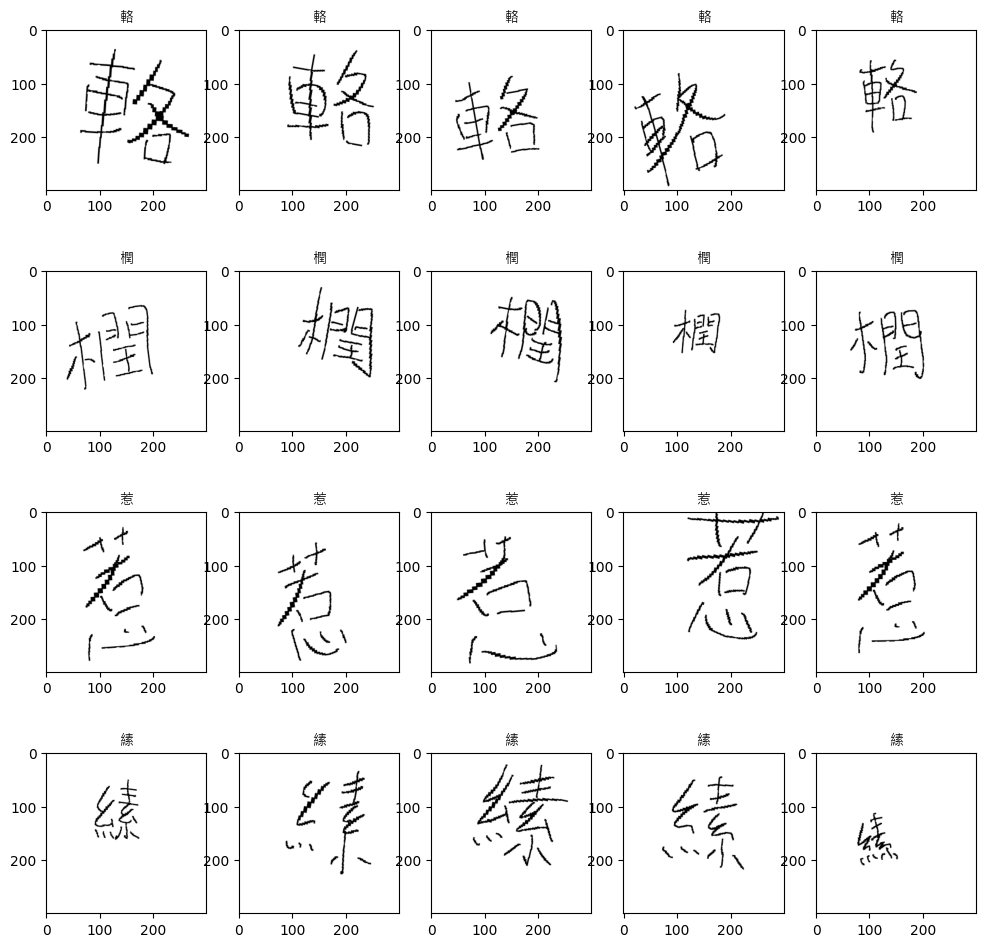

In [ ]:
def Loading_Image( image_path ):
    img = load_img( image_path )
    img = tf.constant( np.array(img) )
    return img

def Show( image, title=None ) :
    if len( image.shape )>3 :
        image = tf.squeeze( image, axis=0 )

    plt.imshow( image )
    if title:
        plt.title( title, fontproperties=font )

img_list: list[Path] = []
for folder_path in DstFolder.iterdir():
    file_names = [item.name for item in  folder_path.iterdir()]
    for i in range(5) :
        img_list.append( folder_path / file_names[i] )

plt.gcf().set_size_inches( (12,12) )
for i in range(20):
    plt.subplot(4,5,i+1)
    title = img_list[i].name.split('_')[-3]
    img = Loading_Image( img_list[i] )
    Show( img, title )

In [ ]:
Num_Classes = len(list( DstFolder.iterdir()))
Image_Size = ( 300, 300 )
Epochs = 25
Batch_Size = 8

print(Num_Classes)

5


In [ ]:
Train_Data_Genetor = ImageDataGenerator( rescale = 1./255, validation_split = 0.2,
                                         width_shift_range = 0.05,
                                         height_shift_range = 0.05,
                                         zoom_range = 0.1,
                                         horizontal_flip = False )

In [ ]:
Train_Generator = Train_Data_Genetor.flow_from_directory( DstFolder ,
                                                          target_size = Image_Size,
                                                          batch_size = Batch_Size,
                                                          class_mode = 'categorical',
                                                          shuffle = True,
                                                          subset = 'training' )

Found 41971 images belonging to 5 classes.


In [ ]:
def Plot_Genetor( imgs, labels=[], grid=(1,10), size=(20,2) ):
    n = len( imgs )
    plt.gcf().set_size_inches(size)
    for i in range(n):
        ax = plt.subplot( grid[0], grid[1], i+1 )
        ax.imshow( imgs[i] )
        if len(labels):
            ax.set_title( f'Label={labels[i]}' )
        ax.set_xticks([]); ax.set_yticks([])
    # plt.show()

batch = 1
for data, label in Train_Generator:
    print( f'batch {batch}: \n shape of images: {data.shape} \n shape of labels: {label.shape}' )
    Plot_Genetor( data, label )
    batch += 1
    if batch > len(Train_Generator):
        break

print( f'There are {len(Train_Generator)} batches.' )

batch 1: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 2: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 3: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 4: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 5: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 6: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 7: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 8: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 9: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 10: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 11: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 12: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 13: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
batch 14: 
 shape of images: (8, 300, 300, 3) 
 shape of labels: (8, 5)
b

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f15964bc040> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

In [ ]:
Val_Data_Genetor = ImageDataGenerator( rescale=1./255, validation_split = 0.2 )

In [ ]:
Val_Generator = Train_Data_Genetor.flow_from_directory( DstFolder ,
                                                        target_size = Image_Size,
                                                        batch_size = Batch_Size,
                                                        class_mode = 'categorical',
                                                        shuffle = True,
                                                        subset = 'validation' )

Found 10490 images belonging to 5 classes.


In [ ]:
CNN = Sequential( name = 'CNN_Model' )
CNN.add( Conv2D( 5, kernel_size = (2,2), padding = 'same',  activation='relu',
                 input_shape = (Image_Size[0],Image_Size[1],3), name = 'Convolution' ) )
CNN.add( MaxPooling2D( pool_size = (2,2),  name = 'Pooling' ) )
CNN.add( Flatten( name = 'Flatten' ) )
CNN.add( Dropout( 0.5, name = 'Dropout_1') )
CNN.add( Dense( 512, activation = 'relu', name = 'Dense' ) )
CNN.add( Dropout( 0.5, name = 'Dropout_2') )
CNN.add( Dense( Num_Classes, activation = 'relu', name = 'Softmax' ) )
CNN.summary()

/tmp/a/.venv/lib/python3.13/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "CNN_Model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Convolution (Conv2D)            │ (None, 300, 300, 5)    │            65 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Pooling (MaxPooling2D)          │ (None, 150, 150, 5)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Flatten (Flatten)               │ (None, 112500)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dropout_1 (Dropout)             │ (None, 112500)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dense (Dense)                   │ (None, 512)            │    57,600,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Dropout_2 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ Softmax (Dense)                 │ (None, 5)              │         2,565 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 57,603,142 (219.74 MB)

 Trainable params: 57,603,142 (219.74 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
CNN.compile( optimizer = Adam(),
             loss = 'categorical_crossentropy',
             metrics = ['accuracy'] )

In [ ]:
History = CNN.fit( Train_Generator,
                   steps_per_epoch = Train_Generator.samples//Batch_Size,
                   validation_data = Val_Generator,
                   validation_steps = Val_Generator.samples//Batch_Size,
                   epochs = Epochs )

Epoch 1/25
 267/5246 ━━━━━━━━━━━━━━━━━━━━ 41:22 499ms/step - accuracy: 0.1997 - loss: 3.4757

KeyboardInterrupt: 

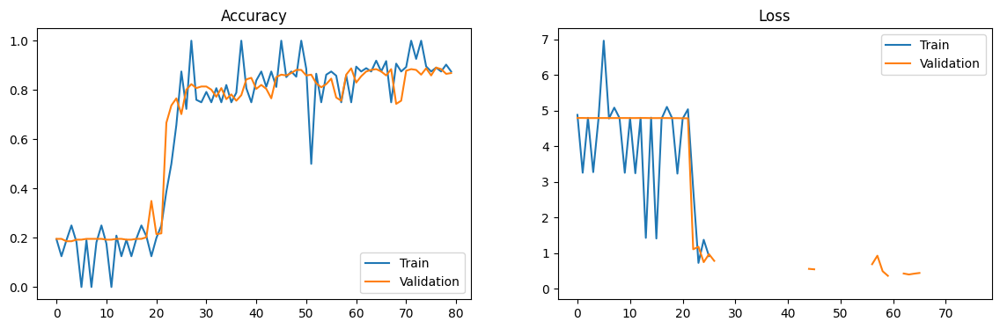

In [ ]:
Train_Accuracy = History.history['accuracy']
Val_Accuracy = History.history['val_accuracy']
Train_Loss = History.history['loss']
Val_Loss = History.history['val_loss']
epochs_range = range(Epochs)

plt.figure( figsize=(14,4) )
plt.subplot( 1,2,1 )
plt.plot( range( len(Train_Accuracy) ), Train_Accuracy, label='Train' )
plt.plot( range( len(Val_Accuracy) ), Val_Accuracy, label='Validation' )
plt.legend( loc='lower right' )
plt.title( 'Accuracy' )

plt.subplot( 1,2,2 )
plt.plot( range( len(Train_Loss) ), Train_Loss, label='Train' )
plt.plot( range( len(Val_Loss) ), Val_Loss, label='Validation' )
plt.legend( loc='upper right' )
plt.title( 'Loss')

plt.show()

In [ ]:
CNN.save( 'CNN_Model.keras' )

In [ ]:
Test_Data_Genetor = ImageDataGenerator( rescale=1./255 )
Test_Generator = Test_Data_Genetor.flow_from_directory( DstFolder,
                                                        target_size = Image_Size,
                                                        shuffle = False,
                                                        class_mode = 'categorical' )

Found 1566 images belonging to 5 classes.


batch 1: 
 shape of images: (32, 300, 300, 3) 
 shape of labels: (32, 5)


ValueError: num must be an integer with 1 <= num <= 10, not 11

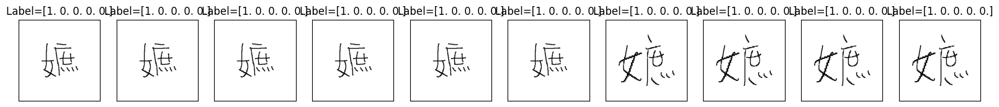

In [ ]:
batch = 1
for data, label in Test_Generator:
    print( f'batch {batch}: \n shape of images: {data.shape} \n shape of labels: {label.shape}' )
    Plot_Genetor( data, label )
    batch += 1
    if batch > 1:
        break

In [ ]:
Test_Generator.reset()

Predicts=CNN.predict(Test_Generator,verbose=1, steps =8)

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 66ms/step


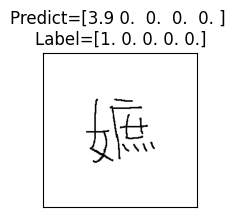

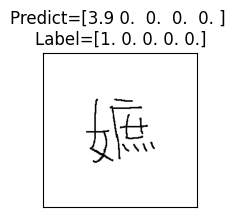

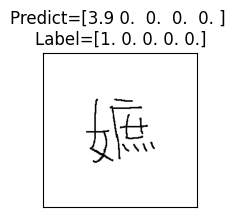

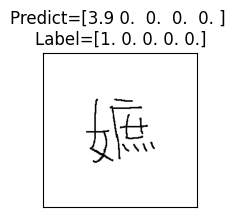

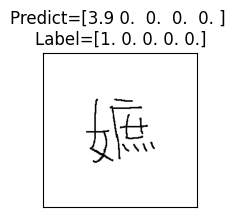

...

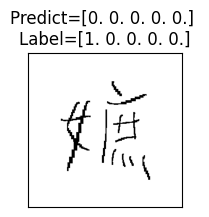

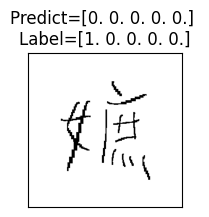

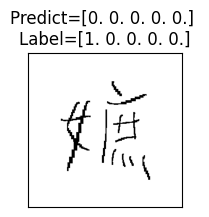

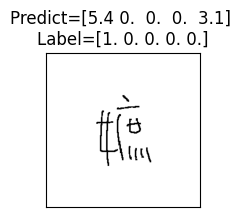

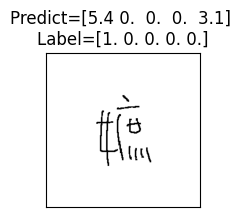

In [ ]:
test_data, test_label = next(Test_Generator)

def Plot_Predict( img, labels=[], predicts=[], size=(20,2) ):
    plt.gcf().set_size_inches(size)
    ax = plt.subplot( )
    ax.imshow( img )
    ax.set_title( f'Predict={predicts.round(1)} \nLabel={labels}' )
    ax.set_xticks([]); ax.set_yticks([])
    plt.show()

for data, label, predict_label in zip(test_data,  test_label, Predicts):
    Plot_Predict( data, label, predict_label )

In [ ]:
TestDir = Path("./test")

if TestDir.exists():
    shutil.rmtree(TestDir)
TestDir.mkdir()

for folder in DstFolder.iterdir():
  for img_file in folder.iterdir():
    shutil.copyfile(img_file,TestDir /  img_file.stem)

['趯', '嫬', '崥', '犦', '秤']
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 637ms/step


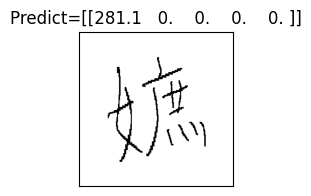

src img: 嫬	 detected: 趯
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


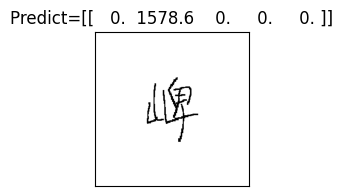

src img: 崥	 detected: 趯
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


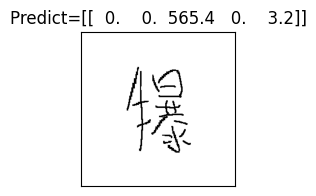

src img: 犦	 detected: 趯
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


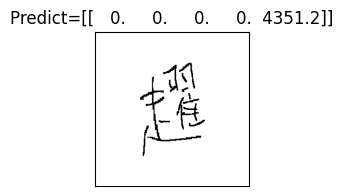

src img: 趯	 detected: 趯
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


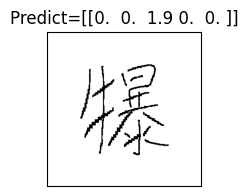

src img: 犦	 detected: 趯


In [ ]:
from keras.preprocessing import image

# load trained model
model = load_model('CNN_Model.keras')

chars = list(set([x.name.split("_")[0] for x in TestDir.iterdir()]))

print(chars)

# predict all photos (loop though the folder)
for img_file in [random.choice(list(TestDir.iterdir())) for _ in range(5)]:
    img = image.load_img(str(img_file), target_size=(300, 300))

    x = image.img_to_array(img)
    x = np.expand_dims(x, axis = 0)
    pred = model.predict(x)

    max_value = pred[0]
    max_index = 0

    for i in range(1, len(pred)):
        if pred[i] > max_value:
            max_value = pred[i]
            max_index = i


    ax = plt.subplot( )
    ax.imshow(img)
    ax.set_title( f'Predict={pred.round(1)}' )
    ax.set_xticks([]); ax.set_yticks([])
    plt.gcf().set_size_inches((20,2))
    plt.show()
    print(f"src img: {img_file.name.split("_")[0] }\t detected: {chars[max_index]}")